In [ ]:
#Kamil Głowacki - Zdjecie panoramiczne

In [8]:
from random import randrange
import matplotlib.pyplot as plt
import numpy as np
import cv2
from PIL import Image

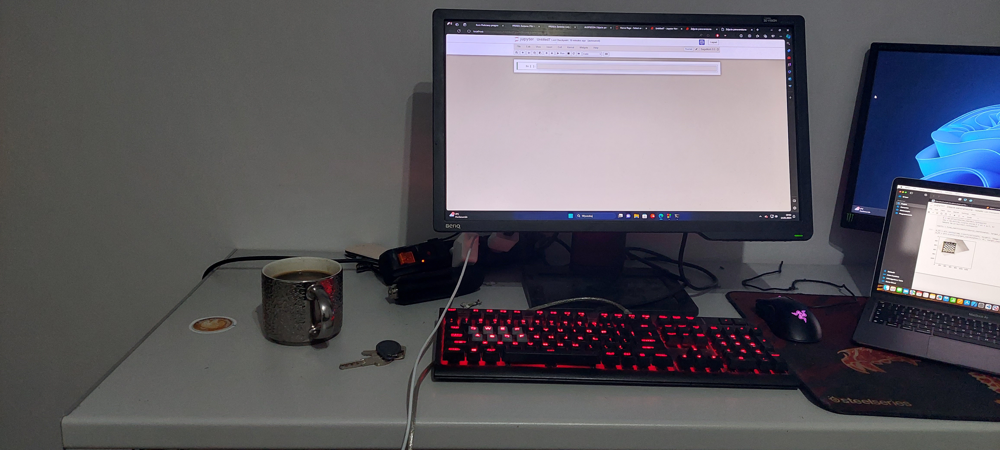

In [9]:
# Punkt kontrolny 1
img1=Image.open("Zdj1.jpg")
width,height=img1.size
img1

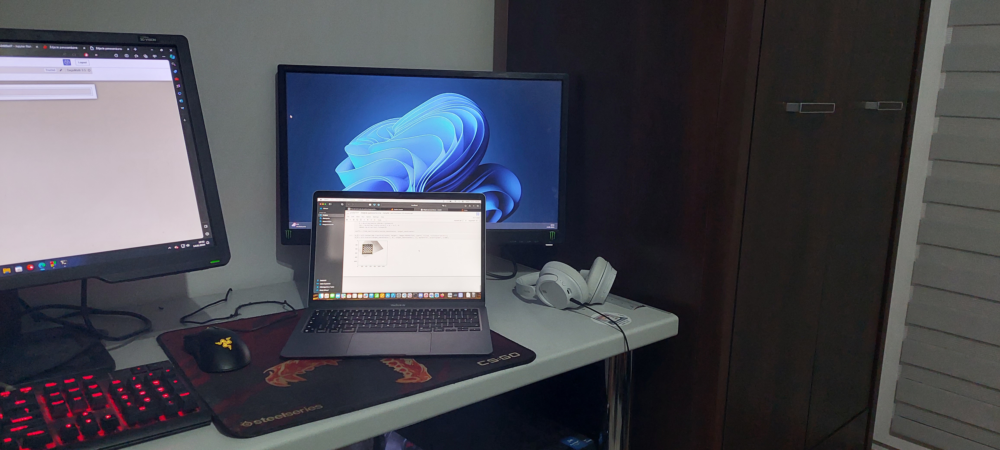

In [10]:
img2=Image.open("Zdj2.jpg")
width,height=img1.size
img2

In [14]:
# Punkt kontrolny 2
figsize = (10, 10)
rgb_l = cv2.cvtColor(cv2.imread("Zdj1.jpg"), cv2.COLOR_BGR2RGB)
gray_l = cv2.cvtColor(rgb_l, cv2.COLOR_RGB2GRAY)
rgb_r = cv2.cvtColor(cv2.imread("Zdj2.jpg"), cv2.COLOR_BGR2RGB)
gray_r = cv2.cvtColor(rgb_r, cv2.COLOR_RGB2GRAY)



##### Regresja liniowa to technika statystyczna używana do analizy związku między jedną zmienną niezależną (inaczej zwaną predyktorem) a zmienną zależną (inaczej zwaną zmienną objaśnianą) w celu przewidywania wartości zmiennej objaśnianej. W przypadku regresji liniowej zakłada się, że istnieje liniowa relacja między zmienną niezależną a zmienną zależną.

Model regresji liniowej można przedstawić matematycznie w postaci równania liniowego:
                $$
                \mathbf{y} = \mathbf{m} \mathbf{x} + \mathbf{b}
                $$

Celem regresji liniowej jest znalezienie takich wartości współczynnika kierunkowego ($m$) i wyrazu wolnego (
$b$), które minimalizują sumę kwadratów różnic między rzeczywistymi wartościami zmiennej zależnej a wartościami przewidywanymi przez model.

In [15]:
# Klasyfikacja punktów wspólnych
source_coordinates = np.array([[3750, 80], [3750, 1075], [3900, 1025], [4025, 200]])

target_coordinates = np.array([[850, 165], [1050, 1175], [1300, 1075], [1300, 325]])

###### Funkcja find_coeffincient ma na celu znalezienie współczynników dla transformacji liniowej pomiędzy zestawami współrzędnych źródłowych i docelowych. Niech $source\_coords = \{(x_1, y_1), (x_2, y_2), \ldots, (x_n, y_n)\}$ oraz $target\_coords = \{(u_1, v_1), (u_2, v_2), \ldots, (u_n, v_n)\}$ będą zestawami współrzędnych źródłowych i docelowych.

Macierz transformacji $A$ jest tworzona w następujący sposób:
A = \begin{bmatrix}
    u_1 & v_1 & 1 & 0 & 0 & 0 & -x_1u_1 & -x_1v_1 \\
    0 & 0 & 0 & u_1 & v_1 & 1 & -y_1u_1 & -y_1v_1 \\
    \vdots & \vdots & \vdots & \vdots & \vdots & \vdots & \vdots & \vdots \\
    u_n & v_n & 1 & 0 & 0 & 0 & -x_nu_n & -x_nv_n \\
    0 & 0 & 0 & u_n & v_n & 1 & -y_nu_n & -y_nv_n \\
\end{bmatrix}


Wektor $b$ jest tworzony przez przekształcenie współrzędnych źródłowych:
$\mathbf{b}$ = \begin{bmatrix}
    x_1 \\ y_1 \\ \vdots \\ x_n \\ y_n
\end{bmatrix}


Wektor współczynników $\mathbf{res}$ jest obliczany jako:
 $\mathbf{res}$ = (A^T A)^{-1} A^T $\mathbf{b}$ 

Funkcja zwraca wektor współczynników $\mathbf{res}$, który reprezentuje transformację liniową pomiędzy współrzędnymi źródłowymi a docelowymi.


In [16]:
def find_coefficients(source_coords, target_coords):
    tmp = []
    for src, tgt in zip(source_coords, target_coords):
        tmp.append([tgt[0],  tgt[1], 1,      0,             0, 0, -src[0]*tgt[0], -src[0]*tgt[1]])
        tmp.append([0,            0, 0, tgt[0],        tgt[1], 1, -src[1]*tgt[0], -src[1]*tgt[1]])
    a = np.matrix(tmp, dtype=float)
    b = np.array(source_coords).reshape(8)
    res = np.dot(np.linalg.inv(a.T * a) * a.T, b)
    return np.array(res).reshape(8)
coeffs = find_coefficients(source_coordinates, target_coordinates)

In [17]:
# Utworzenie macierzy homografii o rozmiarach 3x3
H = np.array([[coeffs[0], coeffs[1], coeffs[2]],
                              [coeffs[3], coeffs[4], coeffs[5]],
                              [coeffs[6], coeffs[7], 1]])

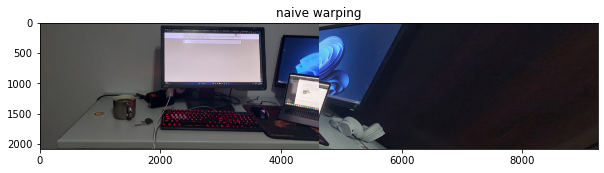

In [18]:
# Połączenie zdjęć
rgb_r_warped = cv2.warpPerspective(rgb_r, H, (rgb_l.shape[1] + rgb_r.shape[1], rgb_l.shape[0]))
rgb_r_warped[0:rgb_l.shape[0], 0:rgb_l.shape[1]] = rgb_l

plt.figure(figsize=figsize)
plt.imshow(rgb_r_warped)
plt.title("naive warping")
plt.show()

##### Jaki maksymalny kąt możemy uchwycić korzystając z odpowiedniego rzutu na płaszczyznę?
Maksymalny kąt wynosi 180 stopni. Wynika to z faktu iż kąty większe niż 180 stopni prowadzą do problemów numerycznych przy uzyskiwaniu macierzy homografii, które powodują zniekształcenia lub deformacje obrazu. Ograniczenie do 180 stopni wynika także z konieczności określenia zakresu kątów w kontekście przestrzeni trójwymiarowej i rzutu na dwuwymiarową płaszczyznę obrazu.